In [1]:
from scipy import ndimage
import glob
import numpy as np
from keras.datasets import mnist
from sklearn.model_selection import train_test_split

Using TensorFlow backend.


In [2]:
X = []
y = []

with open("box_coordinates.csv") as f:
	for line in f:
		data = line.split(",")
		y.append(np.asarray([int(x) for x in data[1:]]))
		image = np.memmap("data/BioID/"+data[0], dtype=np.uint8, shape=(384, 286, 1))
		X.append(image / 255.0)

indices = range(len(X))

X_train, X_test, y_train, y_test, indices_train, indices_test = train_test_split(X, y, indices, test_size=0.15, random_state=37)
X_train = np.asarray(X_train)
y_train = np.asarray(y_train)

X_test = np.asarray(X_test)
y_test = np.asarray(y_test)

In [3]:
print(X_train.shape)
print(y_train.shape)

print(X_test.shape)
print(y_test.shape)

(1283, 384, 286, 1)
(1283, 8)
(227, 384, 286, 1)
(227, 8)


In [4]:
from keras.models import Sequential, Model
from keras.layers import Input, Convolution2D, Flatten
from keras.layers.core import Dense, Activation

In [5]:
image = Input(shape=(384, 286, 1))
y = Convolution2D(32, 3, 3, border_mode='same')(image)
z = Dense(8)(Flatten()(y))
model = Model(image, z)

model.compile(loss='mse', optimizer='rmsprop')

In [6]:
model.fit(X_train, y_train, nb_epoch=10, batch_size=5, verbose=1)

Epoch 1/10
1283/1283 [==============================] - 259s - loss: 5064.8059   
Epoch 2/10
1283/1283 [==============================] - 257s - loss: 788.9011   
Epoch 3/10
1283/1283 [==============================] - 260s - loss: 569.2376   
Epoch 4/10
1283/1283 [==============================] - 236s - loss: 383.3719   
Epoch 5/10
1283/1283 [==============================] - 238s - loss: 368.7380   
Epoch 6/10
1283/1283 [==============================] - 232s - loss: 274.0585   
Epoch 7/10
1283/1283 [==============================] - 240s - loss: 207.6180   
Epoch 8/10
1283/1283 [==============================] - 223s - loss: 188.6134   
Epoch 9/10
1283/1283 [==============================] - 223s - loss: 189.9799   
Epoch 10/10
1283/1283 [==============================] - 221s - loss: 179.2743   


In [10]:
np.set_printoptions(threshold=np.nan)
predictions = model.predict(X_test, batch_size = 16, verbose=1)

227/227 [==============================] - 6s     


In [8]:
model.evaluate(X_test, y_test, batch_size=16, verbose=1)

227/227 [==============================] - 6s     


214.38407397165173

[530,
 1211,
 480,
 577,
 903,
 791,
 459,
 700,
 106,
 721,
 890,
 958,
 580,
 763,
 1134,
 967,
 617,
 746,
 1487,
 130,
 1488,
 183,
 339,
 718,
 313,
 94,
 449,
 72,
 447,
 1247,
 1374,
 537,
 1244,
 479,
 612,
 873,
 851,
 1149,
 899,
 114,
 726,
 322,
 1288,
 36,
 729,
 1160,
 1188,
 1131,
 1375,
 904,
 1009,
 826,
 120,
 606,
 730,
 257,
 1124,
 933,
 634,
 822,
 758,
 523,
 876,
 724,
 140,
 299,
 905,
 1285,
 1321,
 1235,
 1401,
 800,
 581,
 1476,
 1029,
 1427,
 1238,
 1286,
 983,
 1194,
 629,
 321,
 1203,
 1011,
 1462,
 1148,
 56,
 65,
 1493,
 1025,
 1198,
 1469,
 455,
 1218,
 1189,
 534,
 366,
 768,
 1456,
 1094,
 820,
 1416,
 1377,
 603,
 836,
 258,
 553,
 168,
 1174,
 97,
 364,
 1204,
 119,
 749,
 1205,
 1091,
 567,
 650,
 1314,
 521,
 1398,
 1180,
 560,
 938,
 207,
 96,
 550,
 884,
 1372,
 1373,
 1320,
 614,
 5,
 1157,
 1257,
 1404,
 588,
 525,
 1024,
 506,
 33,
 54,
 869,
 193,
 918,
 397,
 685,
 3,
 1335,
 370,
 722,
 792,
 238,
 871,
 878,
 1113,
 466,
 253,
 206,
 353

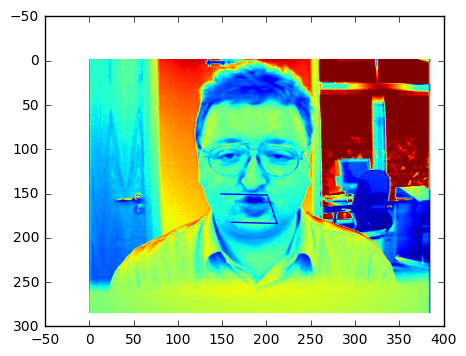

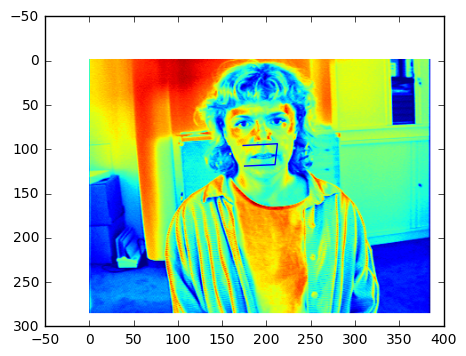

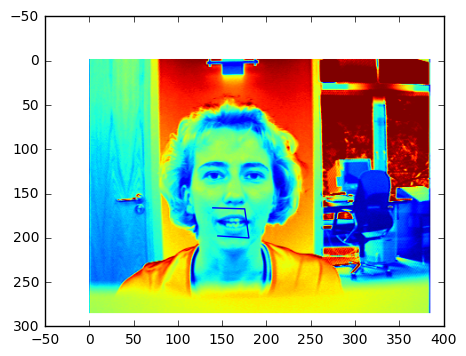

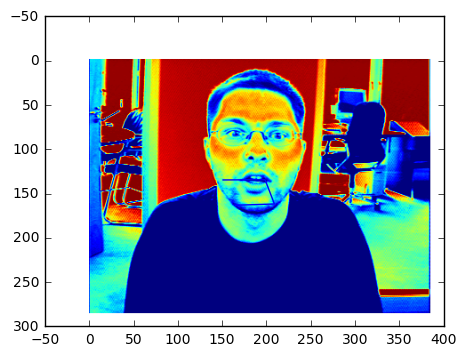

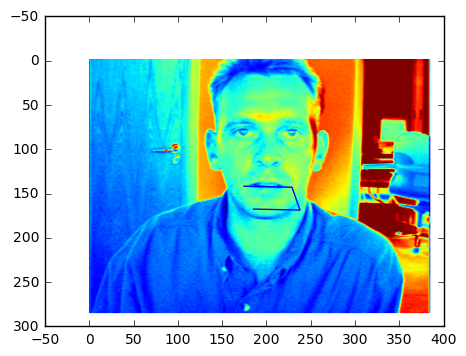

...

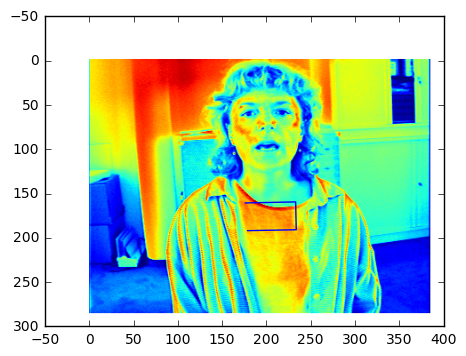

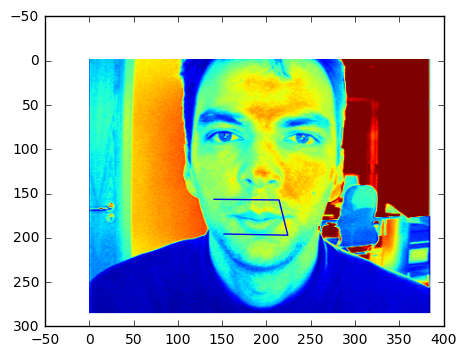

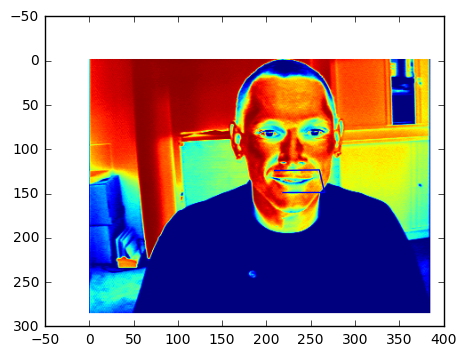

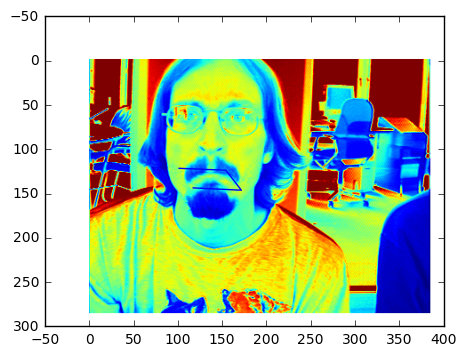

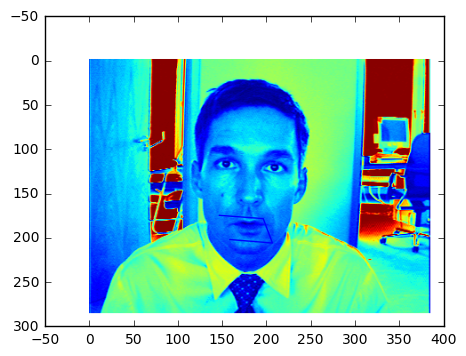

In [12]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

with open("box_coordinates.csv") as f:
    photos = f.readlines()
    
for i,index in enumerate(indices_test):
    title = photos[index].split(',')[0]
    img = mpimg.imread("data/BioID/"+title)
    simgplot = plt.imshow(img)
    x_coords = predictions[i][0::2]
    y_coords = predictions[i][1::2]
    plt.plot(x_coords, y_coords)
    plt.show()

    
    
    